In [ ]:
# Import the required libraries 

import matplotlib.pyplot as plt
from sklearn.datasets import load_files
from skimage.io import imread_collection 
from keras.utils import np_utils
import numpy as np
import pandas as pd 
from glob import glob
import os
import math
from sklearn.model_selection import train_test_split

In [21]:
train_labels = pd.read_csv("../dataset/train_labels.csv")
train_labels.head()

,name,invasive
0,1,0
1,2,0
2,3,1
3,4,0
4,5,1


In [22]:
train_labels.shape

(2295, 2)

In [23]:
train_labels['invasive'].unique()


array([0, 1], dtype=int64)

In [24]:
train_labels['name'].unique()


array([   1,    2,    3, ..., 2293, 2294, 2295], dtype=int64)

In [25]:
train_labels.groupby('invasive').size().sort_values(ascending=False)


invasive
1    1448
0     847
dtype: int64

In [26]:
train_labels.groupby('name').size().sort_values(ascending=False)


name
1       1
1534    1
1528    1
1529    1
1530    1
       ..
760     1
759     1
758     1
757     1
2295    1
Length: 2295, dtype: int64

In [49]:
#proportion of invasive labels in training datasets
train_labels.groupby(['invasive']).size().reset_index(name='counts')

,invasive,counts
0,0,847
1,1,1448


In [50]:
#proportion of name labels in training datasets
train_labels.groupby(['name']).size().reset_index(name='counts')

,name,counts
0,1,1
1,2,1
2,3,1
3,4,1
4,5,1
...,...,...
2290,2291,1
2291,2292,1
2292,2293,1
2293,2294,1


In [27]:
# Read the Files
img_path = "../dataset/train/"

y = []
file_paths = []
for i in range(len(train_labels)):
    file_paths.append( img_path + str(train_labels.iloc[i][0]) +'.jpg' )
    y.append(train_labels.iloc[i][1])
y = np.array(y)

In [28]:
file_paths[:15]

['../dataset/train/1.jpg',
 '../dataset/train/2.jpg',
 '../dataset/train/3.jpg',
 '../dataset/train/4.jpg',
 '../dataset/train/5.jpg',
 '../dataset/train/6.jpg',
 '../dataset/train/7.jpg',
 '../dataset/train/8.jpg',
 '../dataset/train/9.jpg',
 '../dataset/train/10.jpg',
 '../dataset/train/11.jpg',
 '../dataset/train/12.jpg',
 '../dataset/train/13.jpg',
 '../dataset/train/14.jpg',
 '../dataset/train/15.jpg']

In [29]:
y[:15]

array([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0], dtype=int64)

In [45]:
# Examine the total pictures
def number_of_file(my_dir):
    return str(len(os.listdir(my_dir)))

print("# of training files: {}".format(number_of_file("../dataset/train")))
print("# of testing files: {}".format(number_of_file("../dataset/test")))

# of training files: 2295
# of testing files: 1531


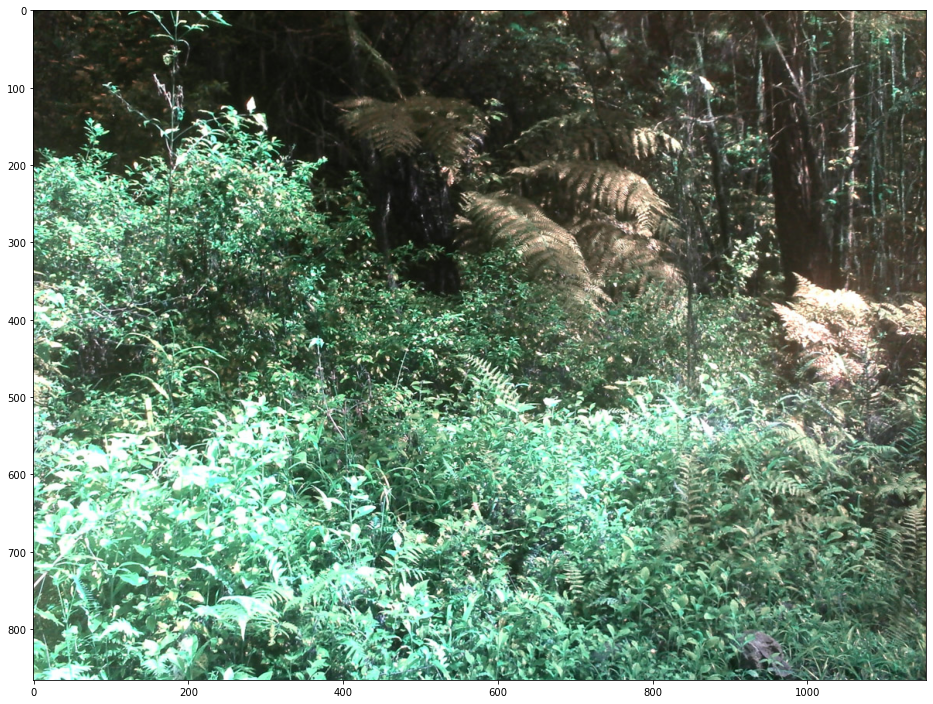

In [57]:
import cv2
image = cv2.imread(file_paths[15])
plt.figure(figsize=(16,16))
plt.imshow(image)

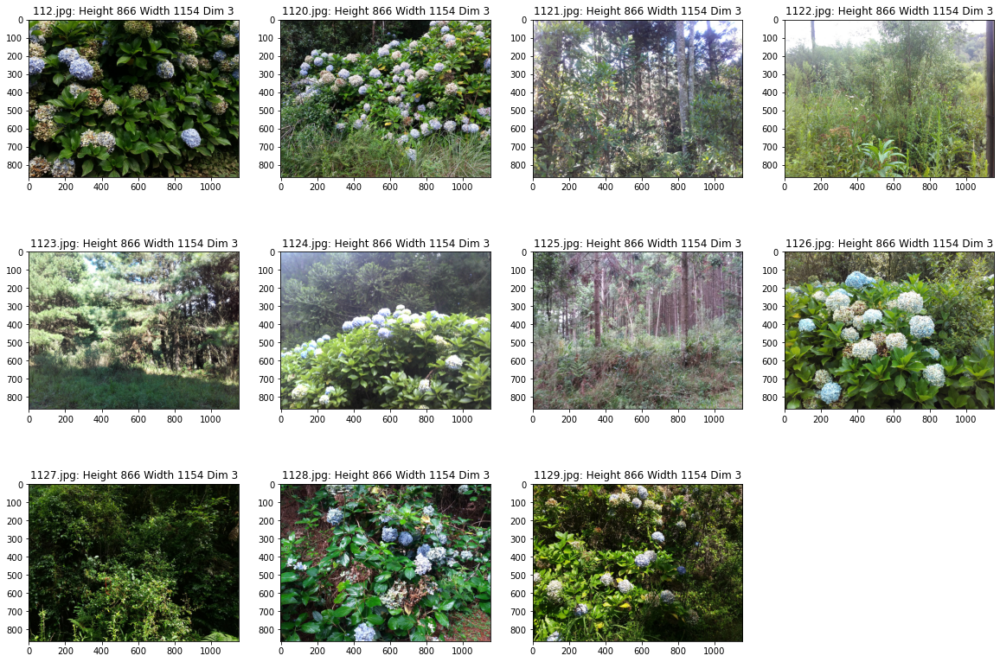

In [52]:
# visualize some images
def img_visual(path, smpl, dim_y):
    
    smpl_pic = glob(smpl)
    fig = plt.figure(figsize=(20, 14))
    
    for i in range(len(smpl_pic)):
        ax = fig.add_subplot(round(len(smpl_pic)/dim_y), dim_y, i+1)
        plt.title("{}: Height {} Width {} Dim {}".format(smpl_pic[i].strip(path),
                                                         plt.imread(smpl_pic[i]).shape[0],
                                                         plt.imread(smpl_pic[i]).shape[1],
                                                         plt.imread(smpl_pic[i]).shape[2]
                                                        )
                 )
        plt.imshow(plt.imread(smpl_pic[i]))
        
    return smpl_pic

smpl_pic = img_visual('..dataset/train\\', '../dataset/train/112*.jpg', 4)

The Image name: ../dataset/train\112.jpg Is Invasive?: [1]


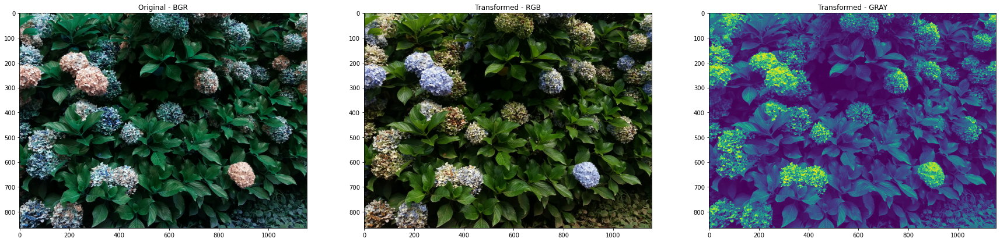

The Image name: ../dataset/train\1120.jpg Is Invasive?: [1]


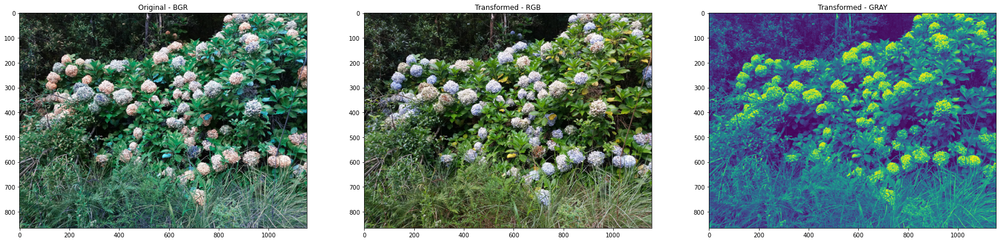

The Image name: ../dataset/train\1121.jpg Is Invasive?: [0]


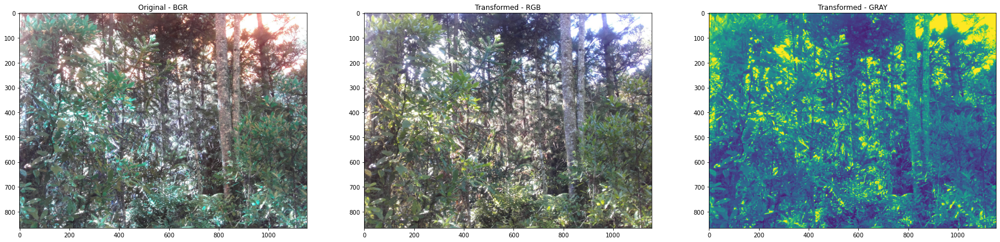

The Image name: ../dataset/train\1122.jpg Is Invasive?: [0]


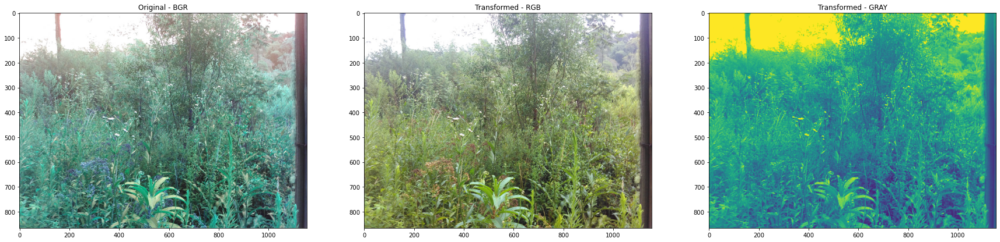

The Image name: ../dataset/train\1123.jpg Is Invasive?: [0]


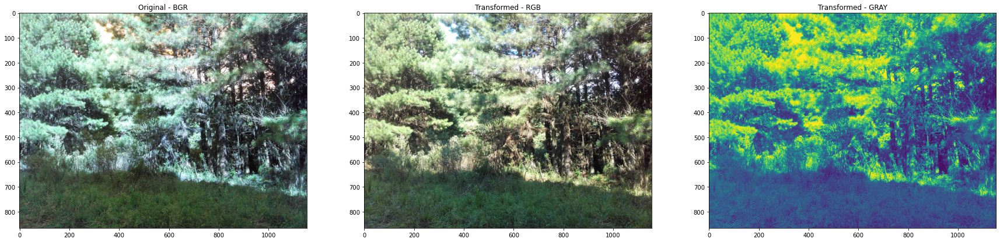

The Image name: ../dataset/train\1124.jpg Is Invasive?: [1]


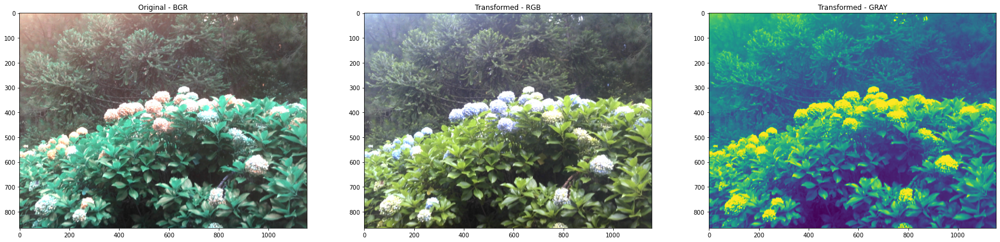

The Image name: ../dataset/train\1125.jpg Is Invasive?: [0]


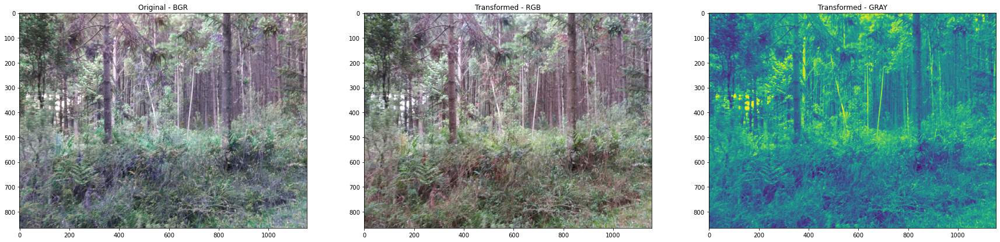

The Image name: ../dataset/train\1126.jpg Is Invasive?: [1]


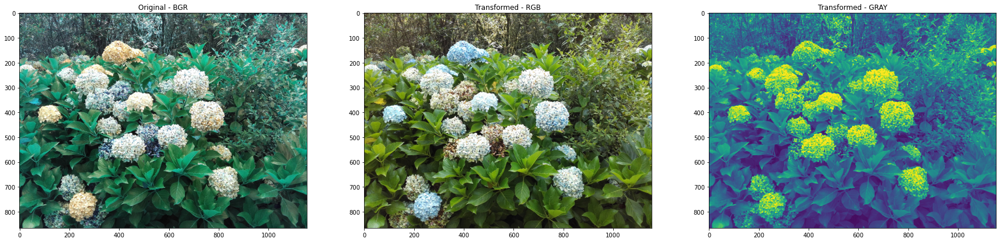

The Image name: ../dataset/train\1127.jpg Is Invasive?: [0]


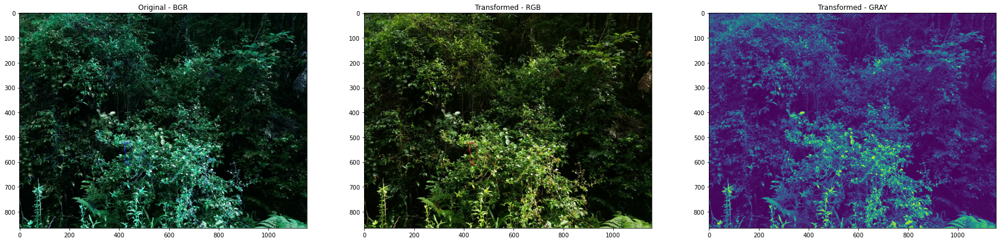

The Image name: ../dataset/train\1128.jpg Is Invasive?: [1]


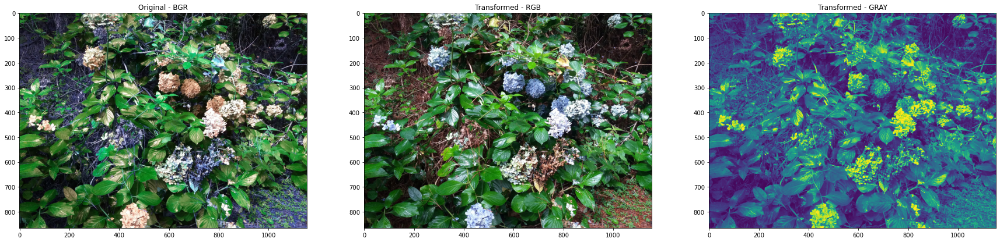

The Image name: ../dataset/train\1129.jpg Is Invasive?: [1]


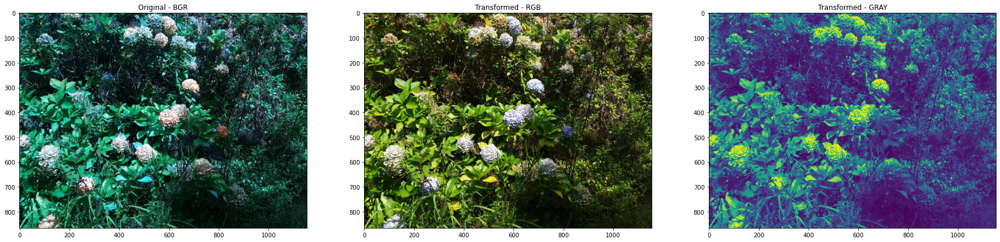

In [56]:
def visual_with_transformation (pic):

    for idx in list(range(0, len(pic), 1)):
        ori_smpl = cv2.imread(pic[idx])
        smpl_1_rgb = cv2.cvtColor(cv2.imread(pic[idx]), cv2.COLOR_BGR2RGB)
        smpl_1_gray =  cv2.cvtColor(cv2.imread(pic[idx]), cv2.COLOR_BGR2GRAY) 

        f, ax = plt.subplots(1, 3,figsize=(30,20))
        (ax1, ax2, ax3) = ax.flatten()
        train_idx = int(pic[idx].strip("../dataset/train\\").strip(".jpg"))
        print("The Image name: {} Is Invasive?: {}".format(pic[idx].strip("train\\"), 
                                                           train_labels.loc[train_labels.name.values == train_idx].invasive.values)
             )
        ax1.set_title("Original - BGR")
        ax1.imshow(ori_smpl)
        ax2.set_title("Transformed - RGB")
        ax2.imshow(smpl_1_rgb)
        ax3.set_title("Transformed - GRAY")
        ax3.imshow(smpl_1_gray)
        plt.show()

visual_with_transformation(smpl_pic)